## Quantity histograms and maps for the SA runset 

In [1]:
import xarray as xr
import glob
import numpy as np
import netCDF4 as nc
import warnings
import matplotlib.path as mpath
import cartopy.feature as cfeature

warnings.filterwarnings('ignore')
from matplotlib import pyplot as plt
from cmocean import cm
import warnings
warnings.filterwarnings('ignore')
import cartopy.crs as ccrs
import sys
sys.path.append('/gpfs/home/mep22dku/scratch/SOZONE/MO_pipeline/')
sys.path.append('/gpfs/home/mep22dku/scratch/SOZONE/UTILS/')
import scendict as sc
import utils as ut

In [2]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')


In [3]:
tmesh = xr.open_dataset('/gpfs/data/greenocean/software/resources/regrid/mesh_mask3_6.nc')
tmesh['csize'] = tmesh.tmask[0,0,:,:] * tmesh.e1t[0,:,:] * tmesh.e2t[0,:,:]

so_csize = (tmesh['csize'][:,:].values)
so_csize_broad = np.zeros([365,149, 182])

for i in range(0,365):
    so_csize_broad[i,:,:] = so_csize

# print(np.shape(so_csize_broad))

In [4]:
def plot_southern(fig, ax1, lons, lats, tdat, tvmin, 
                  tvmax, tticks, northex = -50, fs = 12, 
                  tit = '', cbarlab = '', tcmap = 'viridis', lm = True, cbr = True):
   
    ax1.set_extent([-180, 180, -80, -25], ccrs.PlateCarree())
    #make that circle
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax1.set_boundary(circle, transform=ax1.transAxes)
    lons = nav_lon[0:50,:]; lats = nav_lat[0:50,:]; 
    mesh = ax1.pcolormesh(lons, lats, tdat, cmap = tcmap, vmin = tvmin, vmax = tvmax, 
                     transform=ccrs.PlateCarree())
    
    ax1.add_feature(cfeature.NaturalEarthFeature('physical', 'land', '110m', 
                                                 edgecolor='face', facecolor='k'))
    ax1.set_title(tit, fontsize = fs)
    cb = 0
    if cbr:
        cb = fig.colorbar(mesh, ax = ax1, orientation = 'horizontal',
                     pad = 0.06, fraction = 0.045, shrink = 0.9)
        cb.set_label(label=cbarlab,fontsize = 10)
        cb.set_ticks(tticks, fontsize = 105)
        cb.ax.tick_params(labelsize=10)
    return cb

In [5]:
def get_var_summer(year,runname,var):
    tdir = '/gpfs/home/mep22dku/scratch/SOZONE/MO_RESULTS/EXTRACT/ncs/'
    if var == 'wspd':
        w = xr.open_dataset(f'{tdir}/scen_{runname}_{var}_1948_2100.nc')
    elif var == 'votemper':
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L0_1948_2100.nc')
    elif var == 'EXP':
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L10_1948_2100.nc')
    else:
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_1948_2100.nc')
    tdat = w[var].sel(time_counter=(w.time_counter.dt.month.isin([1, 2, 12])&
                                      w.time_counter.dt.year.isin([year])))
    ts = tdat.values
    tsum = (ts[0,:,:]*31+ts[1,:,:]*28+ts[1,:,:]*31)/90
    return(tsum)

def get_var_winter(year,runname,var):
    tdir = '/gpfs/home/mep22dku/scratch/SOZONE/MO_RESULTS/EXTRACT/ncs/'
    if var == 'wspd':
        w = xr.open_dataset(f'{tdir}/scen_{runname}_{var}_1948_2100.nc')
    elif var == 'votemper':
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L0_1948_2100.nc')
    elif var == 'EXP':
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L10_1948_2100.nc')
    else:
        w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_1948_2100.nc')
    tdat = w[var].sel(time_counter=(w.time_counter.dt.month.isin([6, 7, 8])&
                                      w.time_counter.dt.year.isin([year])))
    ts = tdat.values
    tsum = (ts[0,:,:]*30+ts[1,:,:]*31+ts[1,:,:]*31)/92
    return(tsum)

def dec_avg(syear, run, var, seas = 'winter'):
    stor = np.zeros([10,149,182])
    for i in range(syear, syear+10):
        if seas == 'winter':
            stor[syear-i,:,:] = get_var_winter(syear,run,var)
        elif seas == 'summer':
            stor[syear-i,:,:] = get_var_summer(syear,run,var)
        else:
            print('hm')
    return stor #stor_av

def twentyavg(syear, run, var, seas = 'winter'):
    stor = np.zeros([20,149,182])
    for i in range(syear, syear+20):
        if seas == 'winter':
            stor[syear-i,:,:] = get_var_winter(syear,run,var)
        elif seas == 'summer':
            stor[syear-i,:,:] = get_var_summer(syear,run,var)
        else:
            print('hm')
    return stor #stor_av

def manual_hist(to_hist, to_weights, nbins, rs, re):

    hist_met_vflx, bins = np.histogram(np.ravel(to_hist), bins=nbins,\
                                 range = [rs, re], weights=np.ravel(to_weights))

    bin_cent = bins + (bins[1]-bins[0])/2
    tot_count = np.sum(hist_met_vflx)
    binsback = bin_cent[0:nbins]
    histback = hist_met_vflx/tot_count
    
    return binsback, histback



In [15]:
def twentyavg(syear, run, var, seas = 'winter'):
    stor = np.zeros([20,149,182])
    for i in range(syear, syear+20):
        if seas == 'winter':
            stor[syear-i,:,:] = get_var_winter(syear,run,var)
        elif seas == 'summer':
            stor[syear-i,:,:] = get_var_summer(syear,run,var)
        else:
            print('hm')
    return stor #stor_av

def make_20yr_grids(run,var,tseas):
    twyr = np.zeros([7,149,182])
    for i in range(1950,2090,20):
        syear = i
        stor = twentyavg(syear, run, var, tseas)
        ind = int((i-1950)/20)
        twyr[ind,:,:] = np.nanmean(stor, axis = 0)
    return twyr 

twyr = make_20yr_grids('1ASA','Cflx','winter')

In [16]:
def make_histos(var, varun, scen, longnam, vmin, vmax, count, tcm = cm.dense, leg = False):
    for y in range(1950,2090,20):
        ind = (y-1950)/20;

        w = twentyavg(y,scen,var,seas = 'summer')
        w_so = w[0:20,0:50,:]
        weight = so_csize_broad[0:20,0:50,:]
        binsback, histback = manual_hist(w_so, weight, 30, vmin, vmax)
        axs[0+count].plot(binsback,histback, color = tcm(1.*(ind)/8), label = f'{y}-{y+20}')
        if leg:
            axs[0+count].set_ylabel('prop. of values')
            axs[0+count].set_xlabel(varun)
        w_so = w[0:20,22:37,:]
        weight = so_csize_broad[0:20,22:37,:]
        binsback, histback = manual_hist(w_so, weight, 30, vmin, vmax)
        axs[1+count].plot(binsback,histback, color = tcm(1.*(ind)/8))

        w = twentyavg(y,scen,var,seas = 'winter')
        w_so = w[0:20,0:50,:]
        weight = so_csize_broad[0:20,0:50,:]
        binsback, histback = manual_hist(w_so, weight, 30, vmin, vmax)
        axs[2+count].plot(binsback,histback, color = tcm(1.*(ind)/8), label = f'{y}-{y+20}')

        w_so = w[0:20,22:37,:]
        weight = so_csize_broad[0:20,22:37,:]
        binsback, histback = manual_hist(w_so, weight, 30, vmin, vmax)
        axs[3+count].plot(binsback,histback, color = tcm(1.*(ind)/8), label = f'{y}-{y+20}')
        if leg:
            axs[3+count].legend(bbox_to_anchor = [1, 1])
        
        tits = ['summer (SO <-35)', 'summer (SO -65:-50)', 'winter (SO <-35)', 'winter (SO -65:-50)']
        for i in range(0,4):
            axs[i+count].grid()
            axs[i+count].set_title(f'{longnam} \n {tits[i]}')

In [17]:
import netCDF4 as nc
basin = nc.Dataset('/gpfs/data/greenocean/software/resources/ModelResources/BasinMasks/clq_basin_masks_ORCA.nc')
nav_lat = basin['Y'][:]
nav_lon = basin['X'][:]
lons = nav_lon[0:50,:]
lats = nav_lat[0:50,:]

def make_progplots(run,nam,var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, count, titon = True):
    twyr = make_20yr_grids(run,var,tseas)
    for i in range(1,8):
        ax1 = tfig.add_subplot(6, 7, i+count, projection=ccrs.Orthographic(0, -90))

        if i == 1:
            tnam = sc.scen[nam]['name2']
            plot_southern(tfig, ax1, lons, lats, twyr[i-1,0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = f'{tnam} \n 1950-1970', cbarlab = varun, tcmap = tcm, lm = True, cbr = True)
        else:
            if titon:
                s = 1950+(i-1)*20; e = s+20; ttit = f'{s}-{e} - \n 1950-1970'
            else:
                s = 1950+(i-1)*20; e = s+20; ttit = f'{s}-{e} - \n 1950-1970'
            plot_southern(tfig, ax1, lons, lats, twyr[i-1,0:50,:]-twyr[0,0:50,:] , dmin, 
                          dmax, dtticks, northex = -50, fs = 12, 
                          tit = ttit, cbarlab = '', tcmap = cm.balance_r, lm = True, cbr = True)

In [8]:
#def make_histos(var, varun, scen, longnam, vmin, vmax, count, tcm = cm.dense):

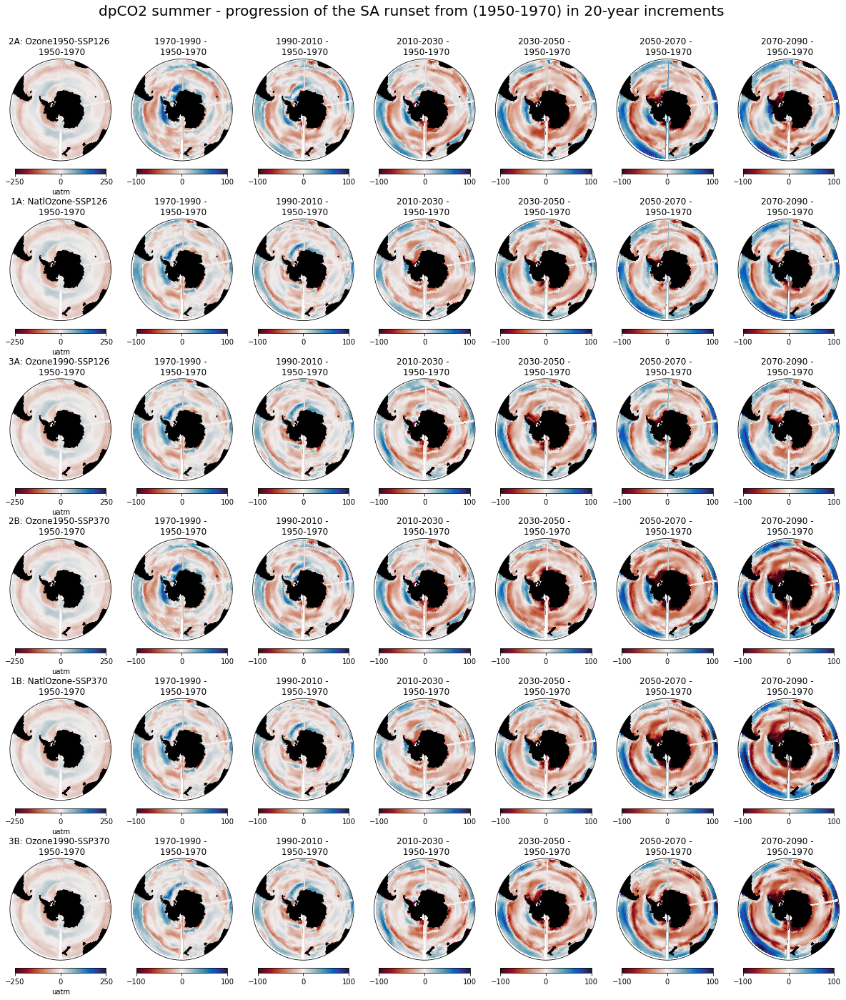

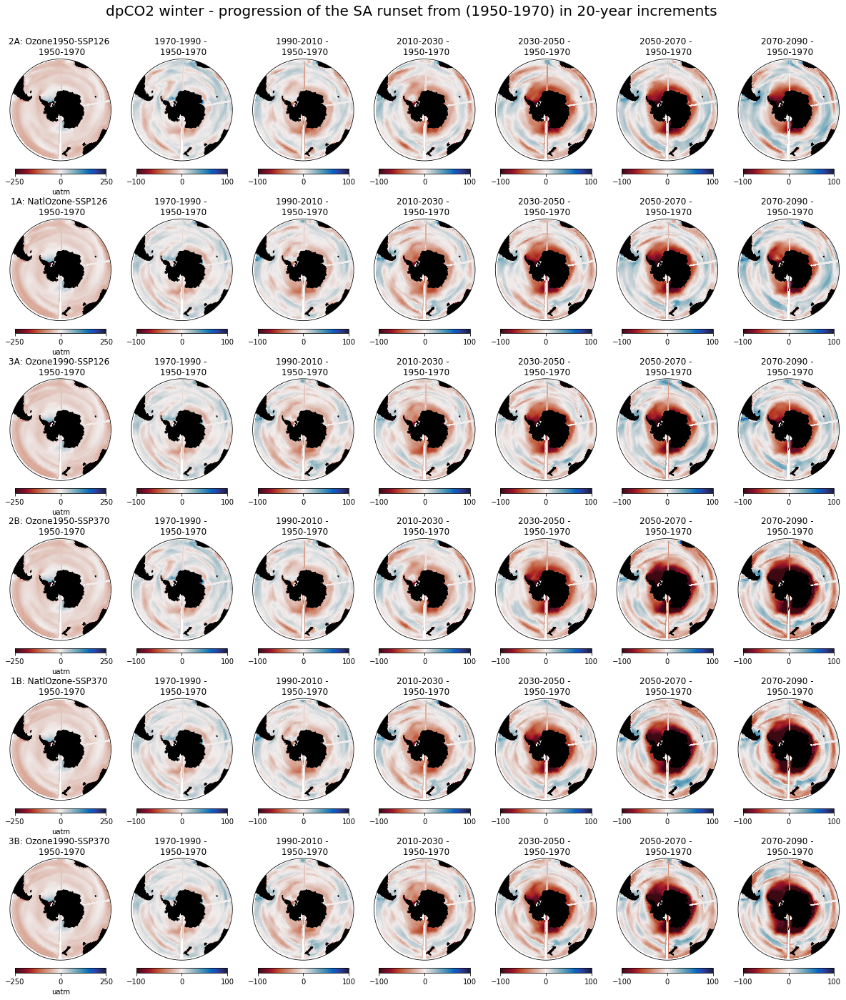

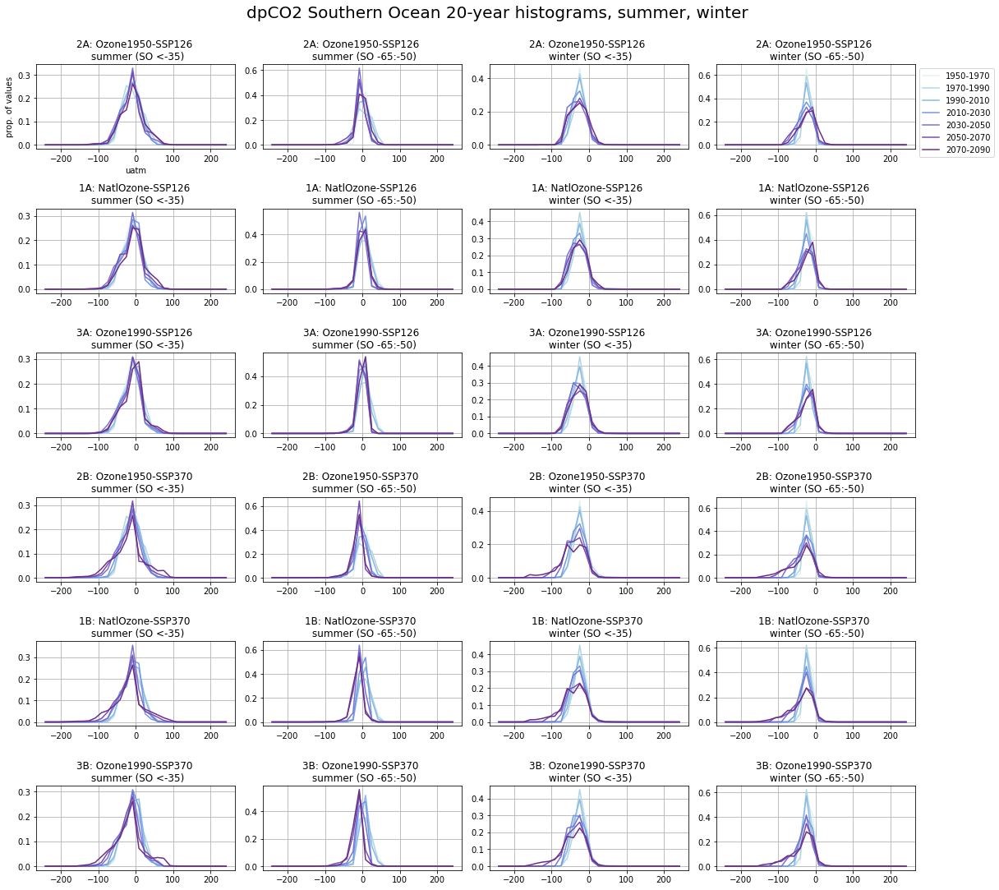

In [18]:
var = 'dpCO2'; varun = 'uatm'
#for histograms
vmin = -250; vmax = 250
#for plots
tvmin = -250; tvmax = 250; tticks = [-250, 0, 250]
dmin = -100; dmax = 100; dtticks = [-100, 0, 100]
tcm = cm.balance_r

## summer maps
tseas = 'summer'; 
fact = 0.4
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2ASA', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1ASA', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3ASA', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2BSA', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1BSA', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3BSA', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')



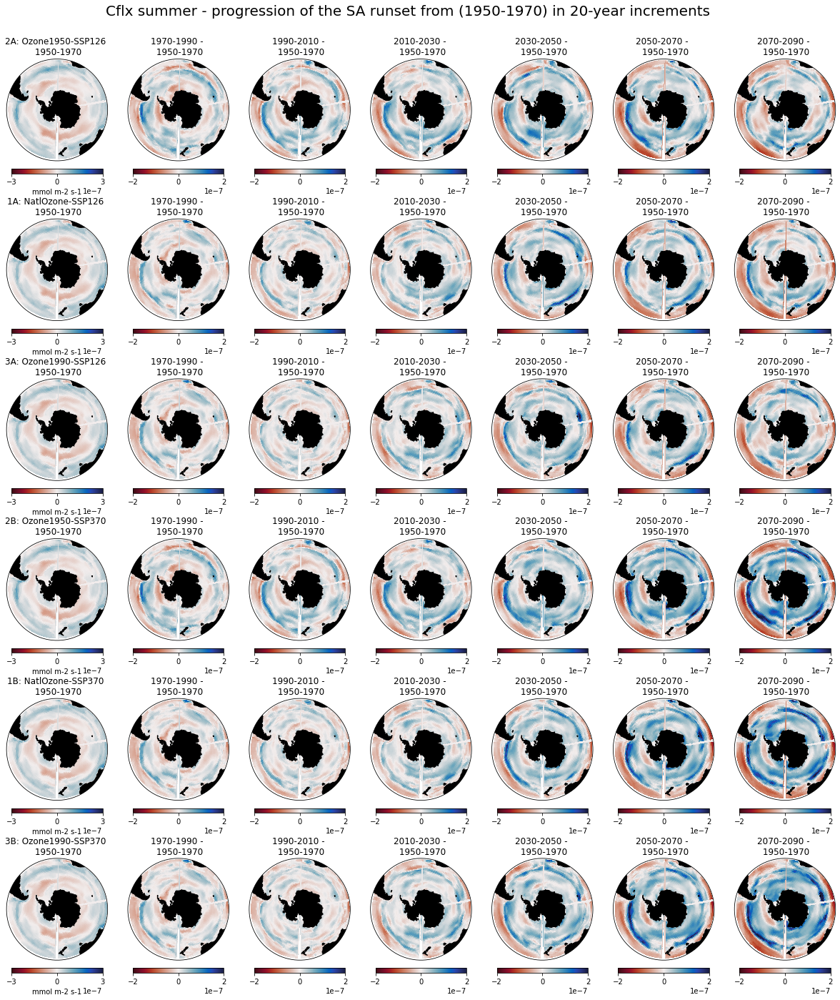

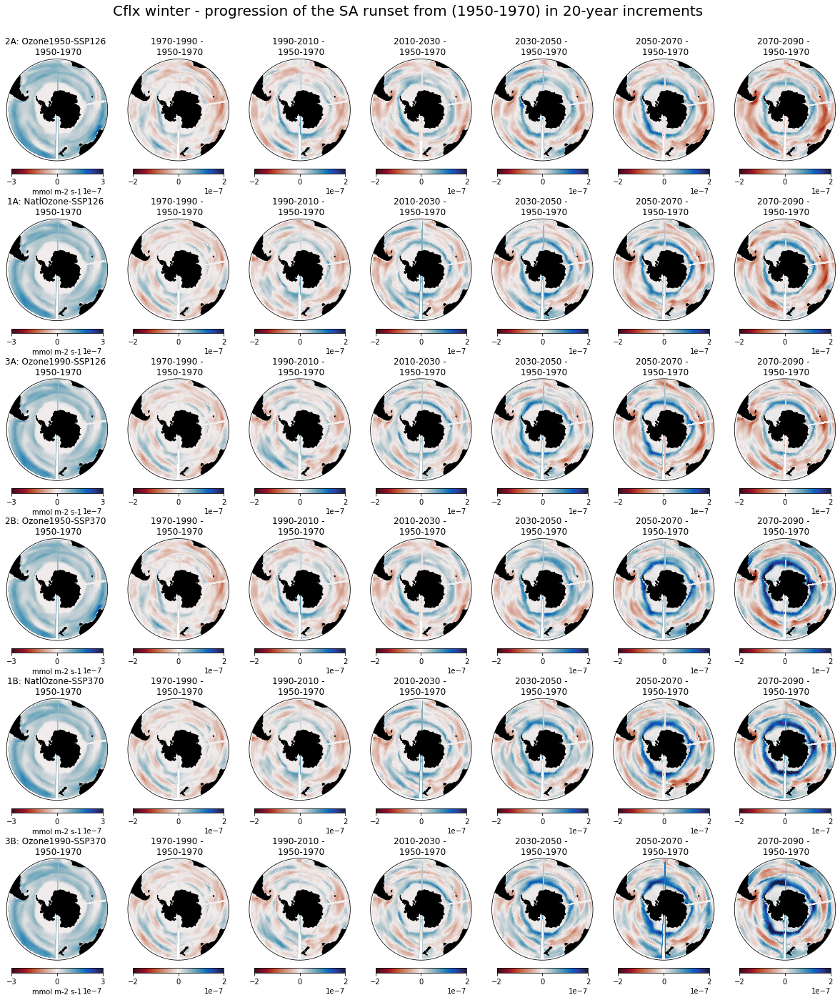

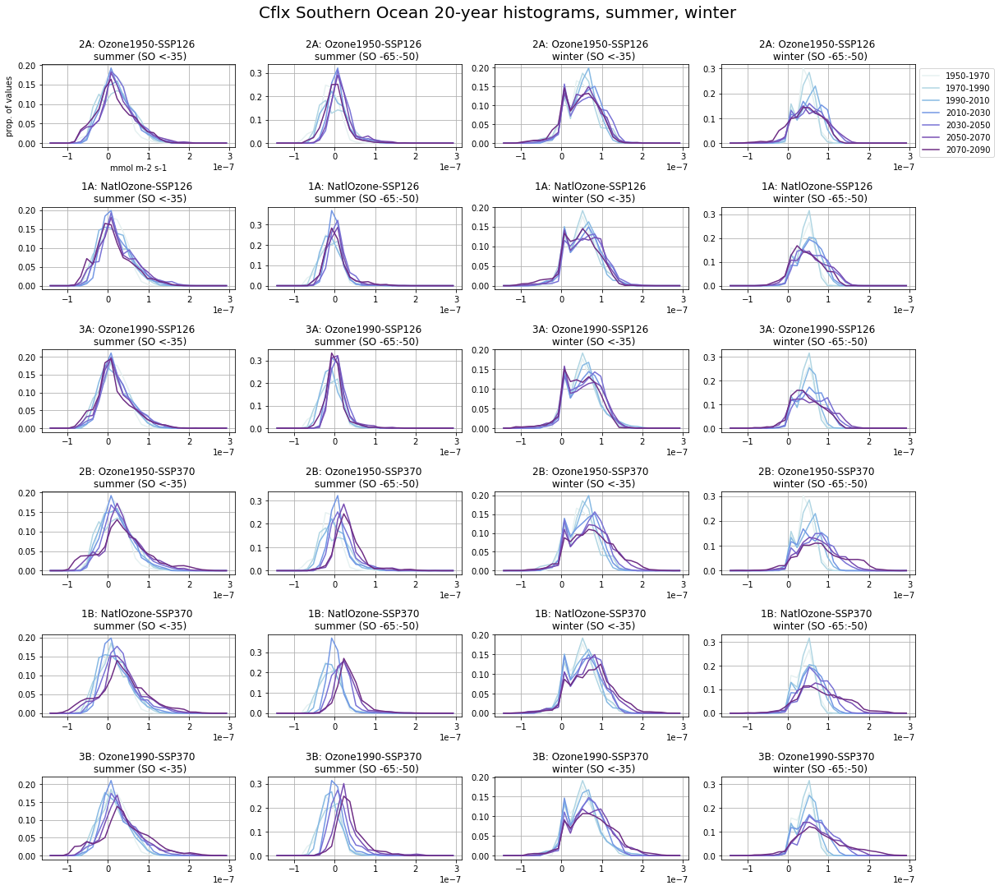

In [41]:
var = 'Cflx'; varun = 'mmol m-2 s-1'
#for histograms
vmin = -1.5e-7; vmax = 3e-7
#for plots
tvmin = -3e-7; tvmax = 3e-7; tticks = [-3e-7, 0, 3e-7]
dmin = -2e-7; dmax = 2e-7; dtticks = [-2e-7, 0, 2e-7]
tcm = cm.balance_r

## summer maps
tseas = 'summer'; 
fact = 0.4
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2ASA', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1ASA', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3ASA', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2BSA', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1BSA', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3BSA', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')



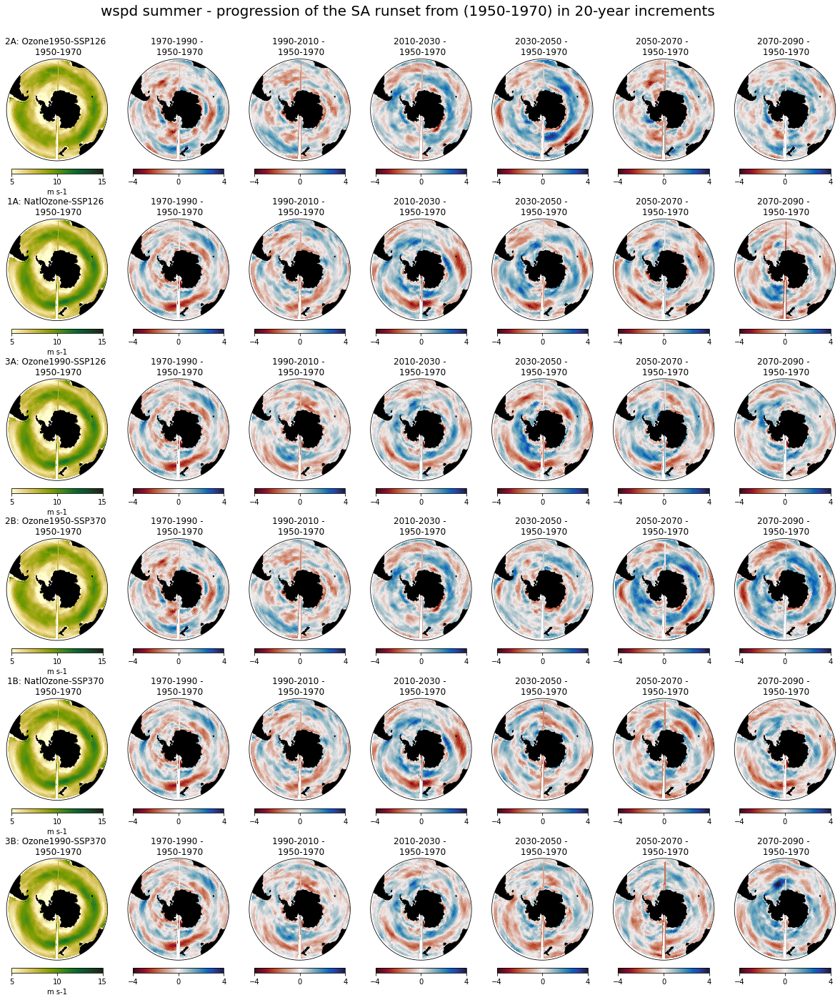

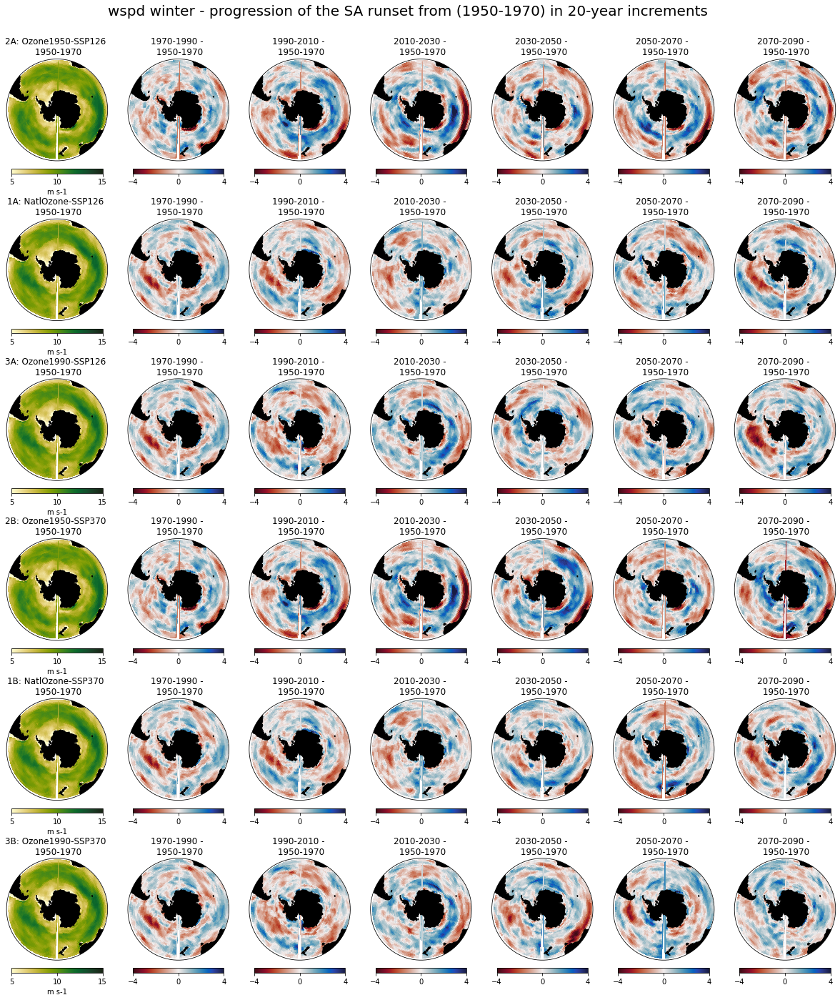

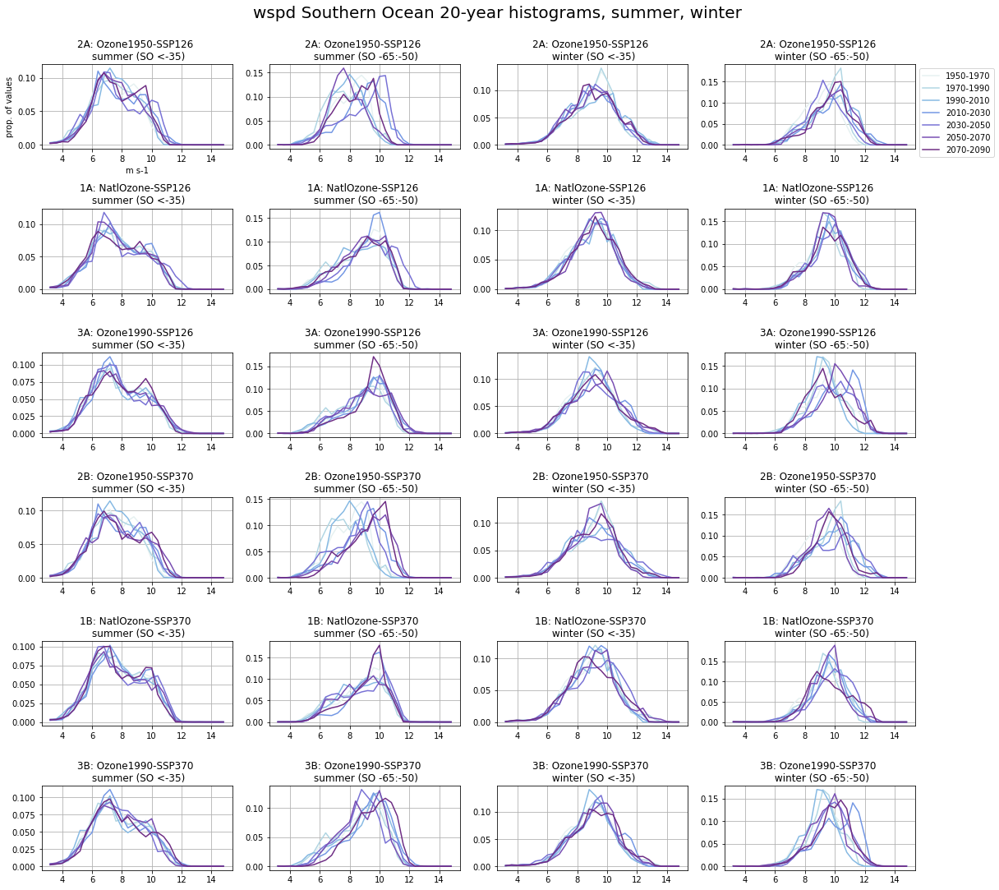

In [34]:
var = 'wspd'; varun = 'm s-1'
#for histograms
vmin = 3; vmax = 15
tvmin = 5; tvmax = 15; tticks = [5, 10, 15]
dmin = -4; dmax = 4; dtticks = [-4, 0, 4]
tcm = cm.speed

## summer maps
tseas = 'summer'; 
fact = 0.4
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2A','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1A','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3A','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2B','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1B','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3B','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2A','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1A','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3A','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2B','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1B','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3B','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2A', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1A', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3A', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2B', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1B', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3B', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')



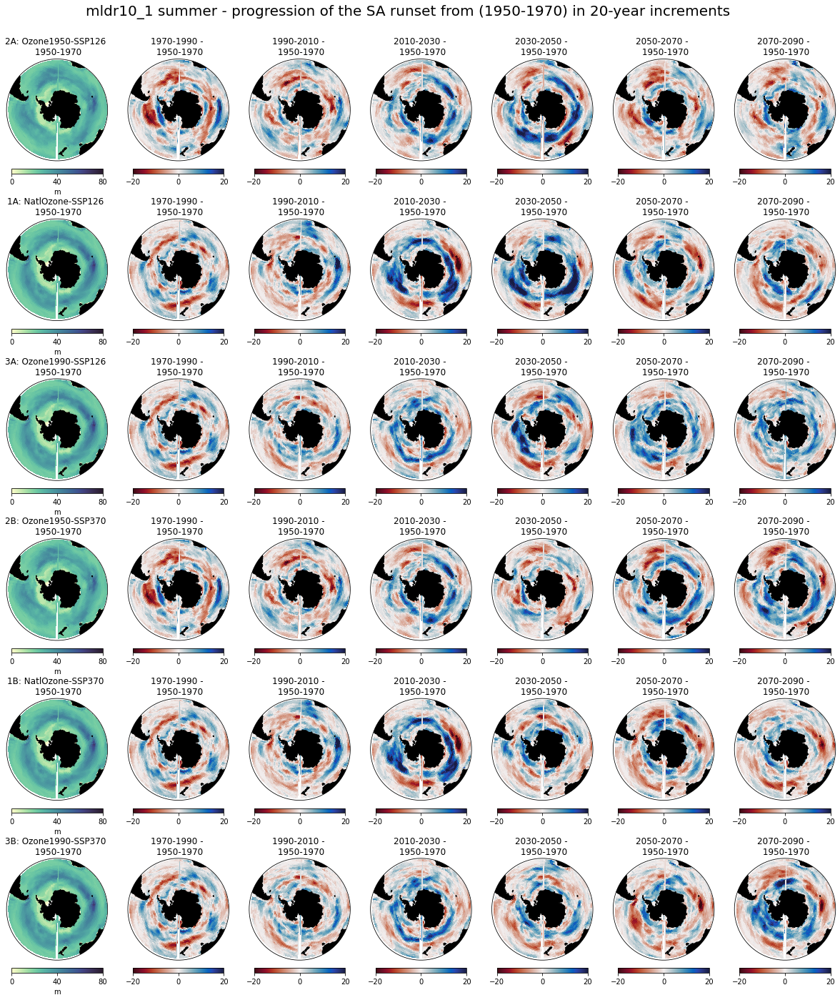

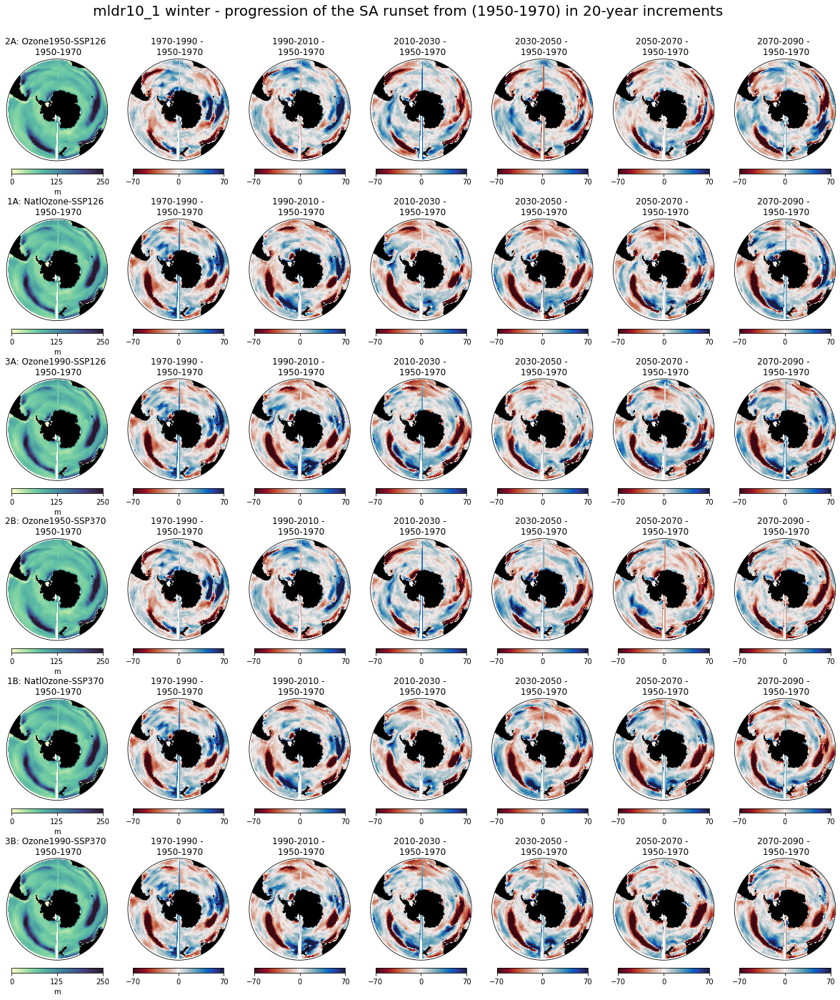

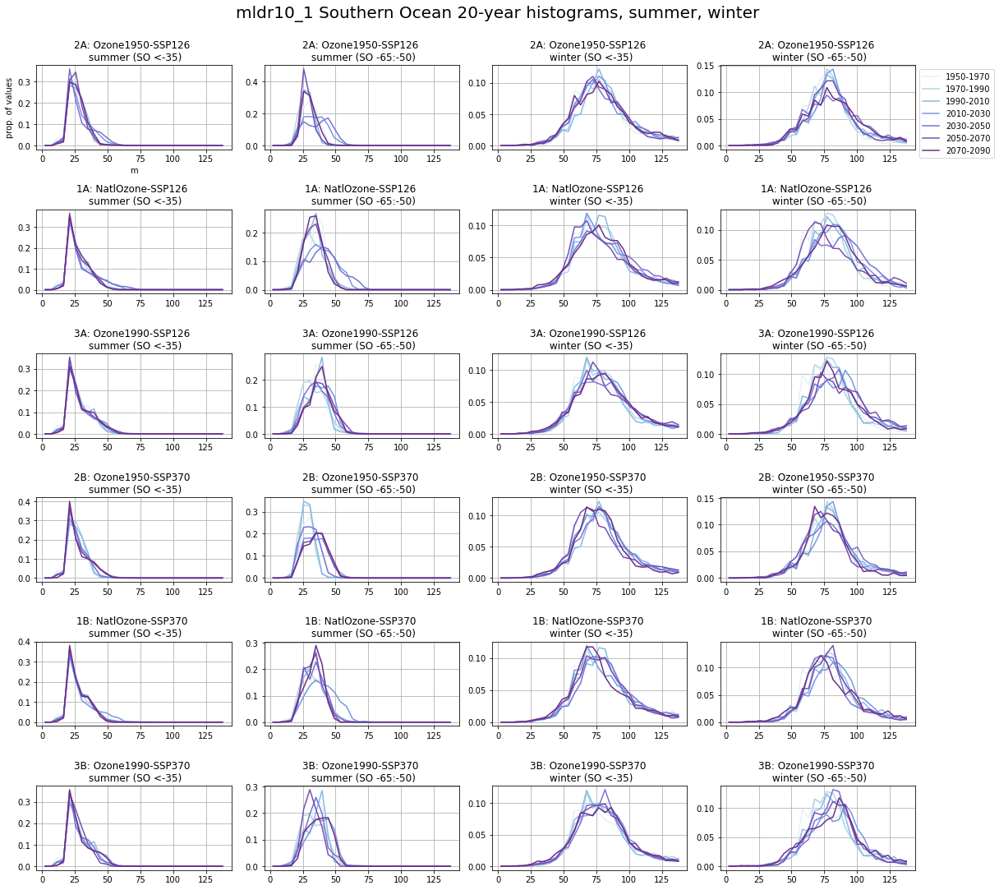

In [39]:
var = 'mldr10_1'; varun = 'm'
#for histograms
vmin = 0; vmax = 140
dmin = -30; dmax = 30; dtticks = [dmin, 0, dmax]
tcm = cm.deep

## summer maps
tseas = 'summer'; 
fact = 0.4
tvmin = 0; tvmax = 80; tticks = [0, 40, 80]
dmin = -20; dmax = 20; dtticks = [dmin, 0, dmax]
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tvmin = 0; tvmax = 250; tticks = [0, 125, 250]
dmin = -70; dmax = 70; dtticks = [dmin, 0, dmax]
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2ASA', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1ASA', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3ASA', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2BSA', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1BSA', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3BSA', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')




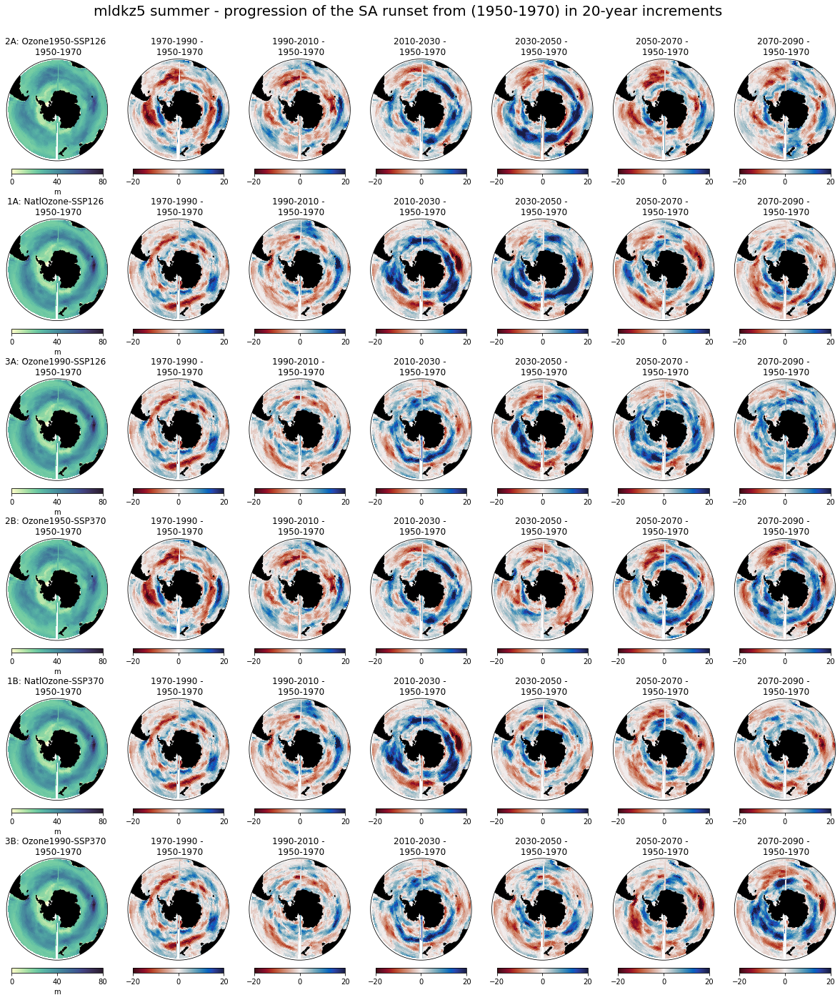

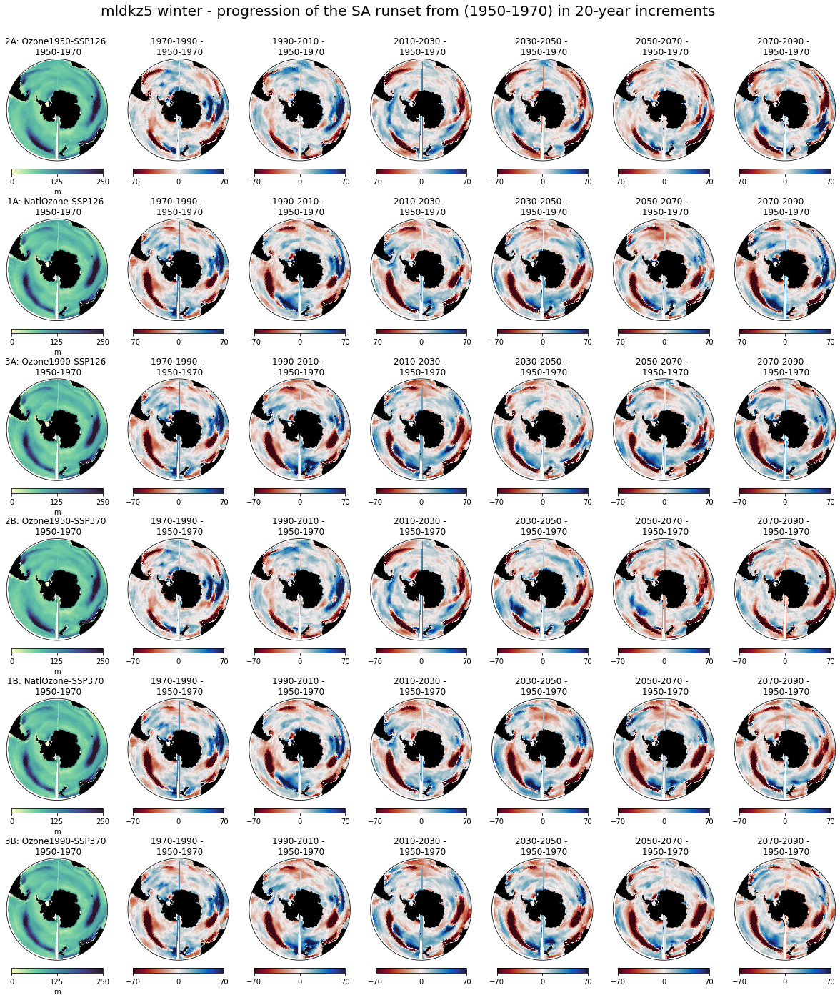

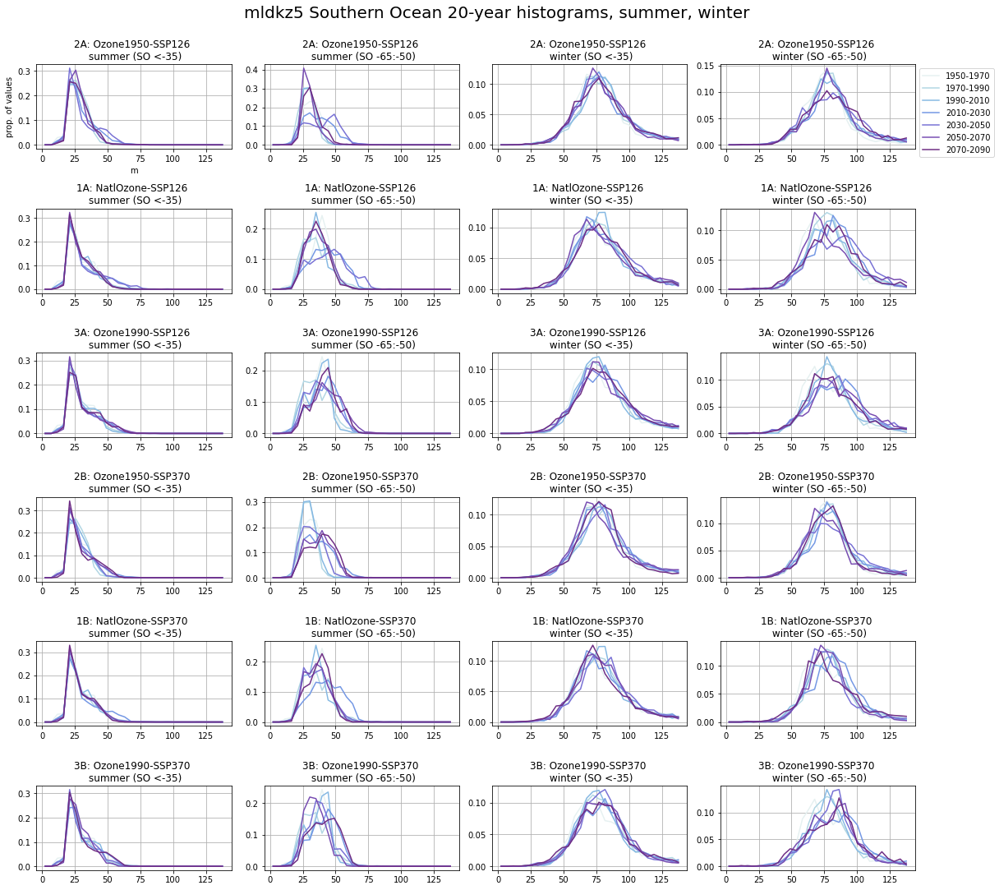

In [40]:
var = 'mldkz5'; varun = 'm'
#for histograms
vmin = 0; vmax = 140
dmin = -30; dmax = 30; dtticks = [dmin, 0, dmax]
tcm = cm.deep

## summer maps
tseas = 'summer'; 
fact = 0.4
tvmin = 0; tvmax = 80; tticks = [0, 40, 80]
dmin = -20; dmax = 20; dtticks = [dmin, 0, dmax]
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tvmin = 0; tvmax = 250; tticks = [0, 125, 250]
dmin = -70; dmax = 70; dtticks = [dmin, 0, dmax]
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplots('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplots('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplots('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplots('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplots('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplots('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2ASA', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1ASA', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3ASA', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2BSA', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1BSA', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3BSA', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')




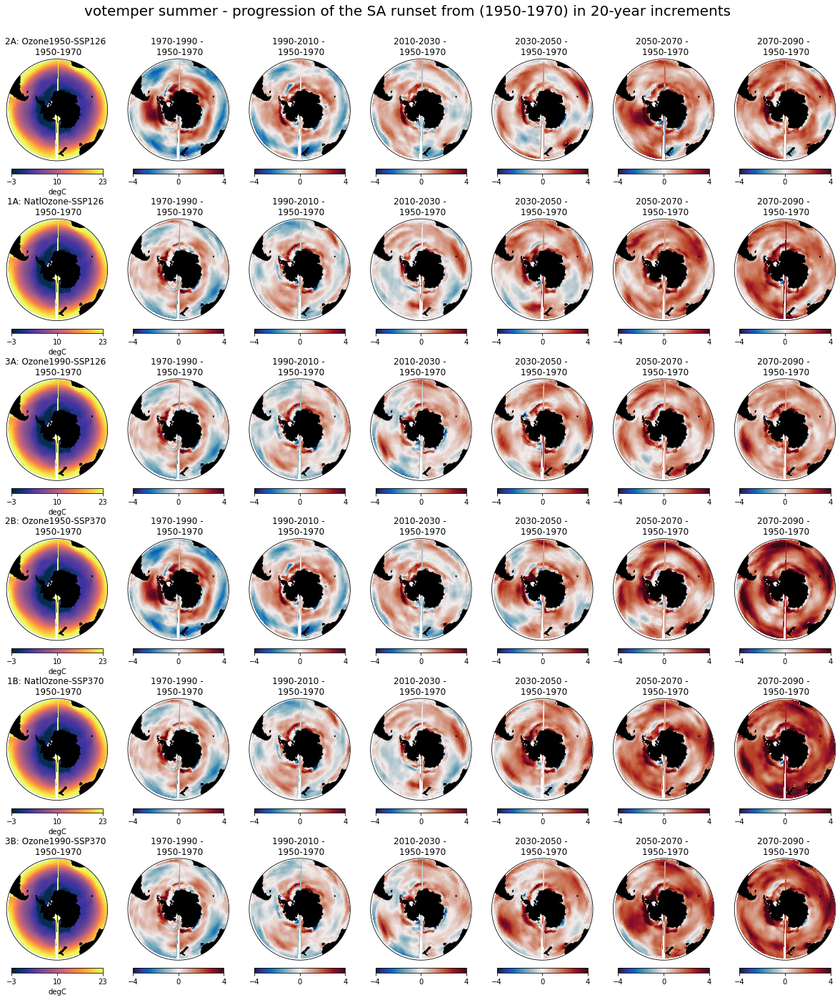

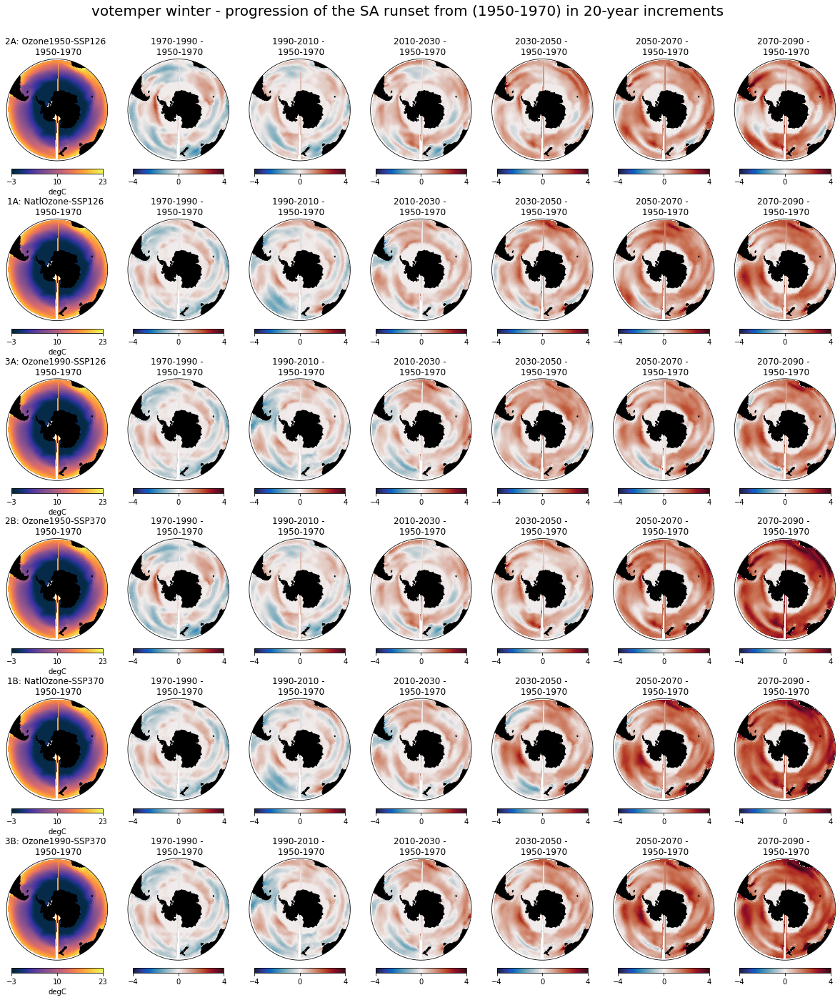

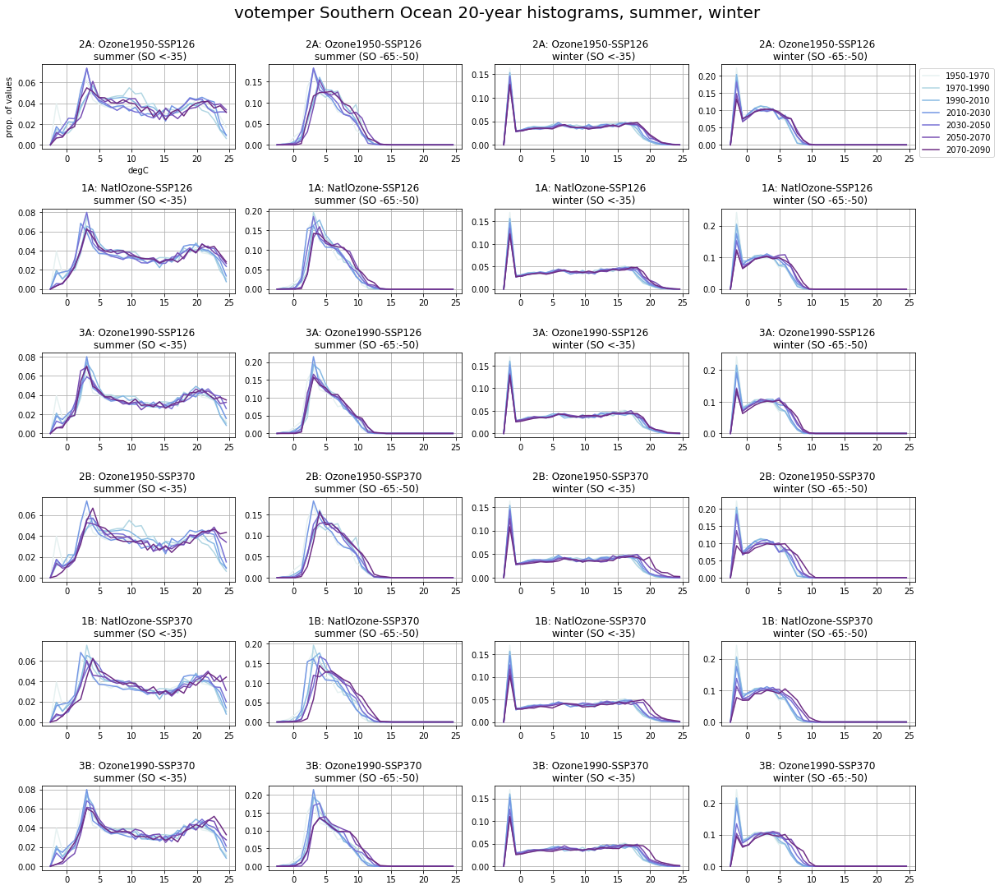

In [43]:
def make_progplotst(run,nam,var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, count, titon = True):
    twyr = make_20yr_grids(run,var,tseas)
    for i in range(1,8):
        ax1 = tfig.add_subplot(6, 7, i+count, projection=ccrs.Orthographic(0, -90))

        if i == 1:
            tnam = sc.scen[nam]['name2']
            plot_southern(tfig, ax1, lons, lats, twyr[i-1,0:50,:], tvmin, 
                          tvmax, tticks, northex = -50, fs = 12, 
                          tit = f'{tnam} \n 1950-1970', cbarlab = varun, tcmap = tcm, lm = True, cbr = True)
        else:
            if titon:
                s = 1950+(i-1)*20; e = s+20; ttit = f'{s}-{e} - \n 1950-1970'
            else:
                s = 1950+(i-1)*20; e = s+20; ttit = f'{s}-{e} - \n 1950-1970'
            plot_southern(tfig, ax1, lons, lats, twyr[i-1,0:50,:]-twyr[0,0:50,:] , dmin, 
                          dmax, dtticks, northex = -50, fs = 12, 
                          tit = ttit, cbarlab = '', tcmap = cm.balance, lm = True, cbr = True)
var = 'votemper'; varun = 'degC'
#for histograms
vmin = -3; vmax = 25
#for plots
tvmin = -3; tvmax = 23; tticks = [-3, 10, 23]
dmin = -4; dmax = 4; dtticks = [dmin, 0, dmax]
tcm = cm.thermal

## summer maps
tseas = 'summer'; 
fact = 0.4
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplotst('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplotst('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplotst('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplotst('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplotst('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplotst('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplotst('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplotst('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplotst('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplotst('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplotst('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplotst('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2ASA', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1ASA', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3ASA', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2BSA', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1BSA', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3BSA', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')



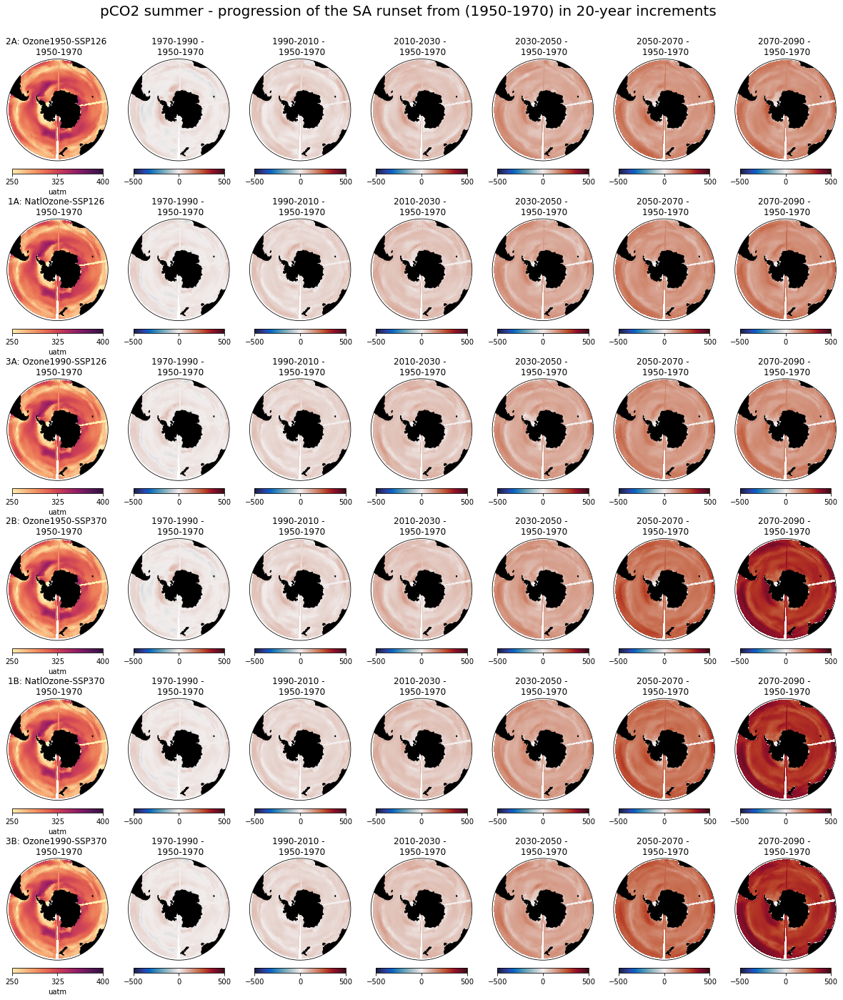

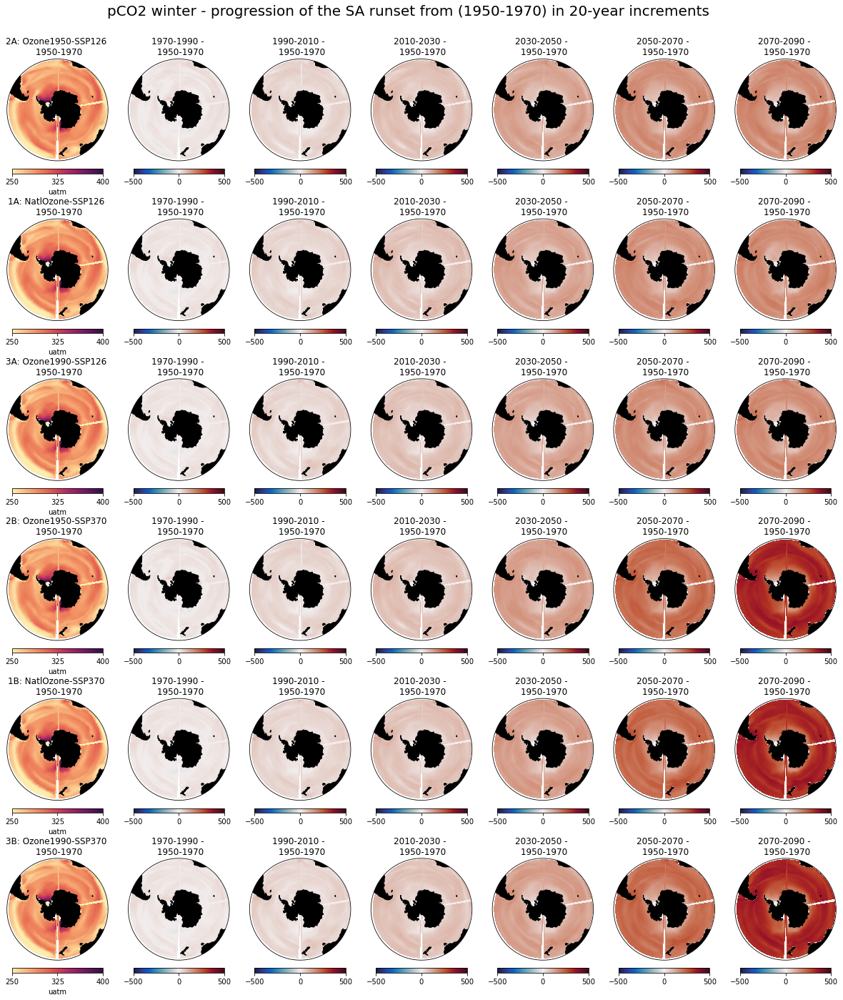

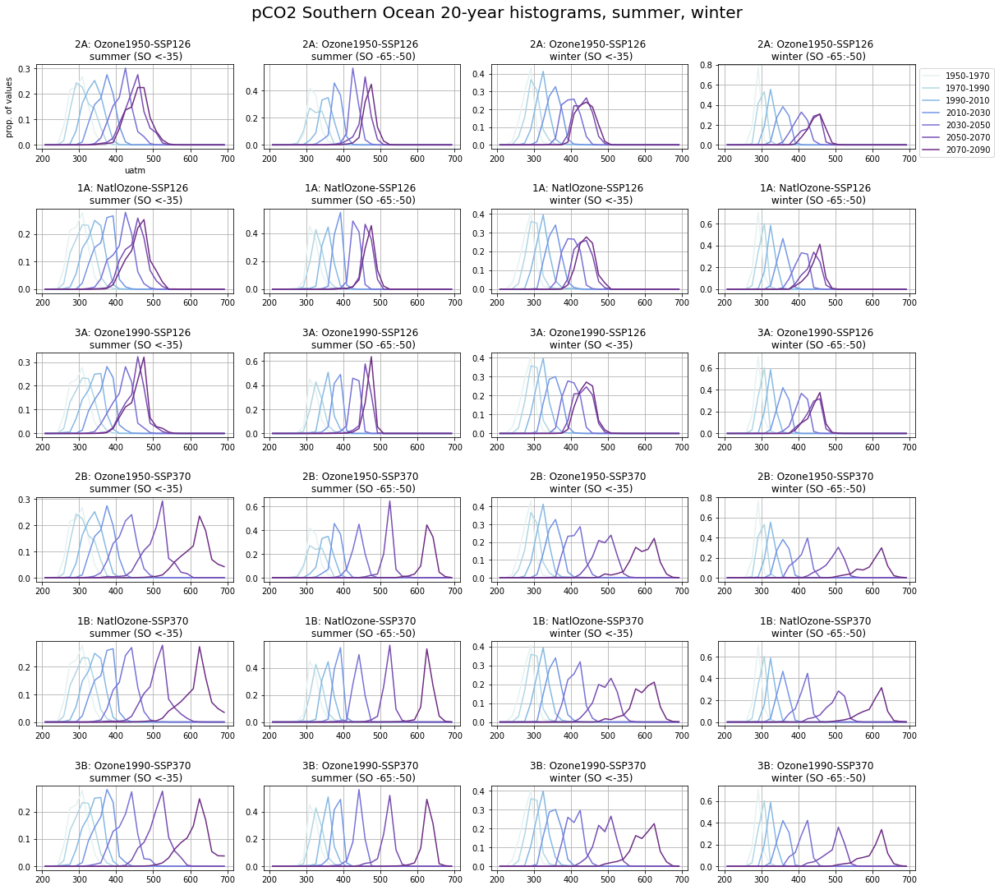

In [46]:
var = 'pCO2'; varun = 'uatm'
#for histograms
vmin = 200; vmax = 700
#for plots
tvmin = 250; tvmax = 400; tticks = [250, 325, 400]
dmin = -500; dmax = 500; dtticks = [-500, 0, 500]
tcm = cm.matter

## summer maps
tseas = 'summer'; 
fact = 0.4
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplotst('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplotst('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplotst('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplotst('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplotst('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplotst('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplotst('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplotst('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplotst('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplotst('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplotst('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplotst('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2ASA', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1ASA', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3ASA', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2BSA', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1BSA', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3BSA', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')



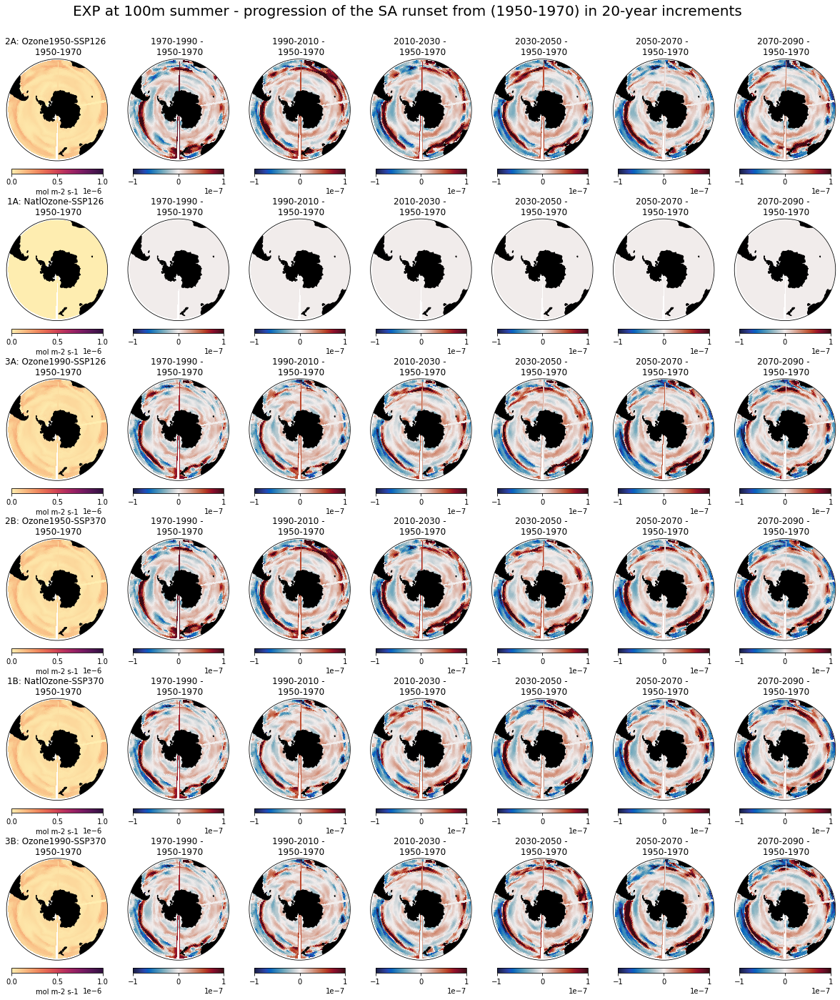

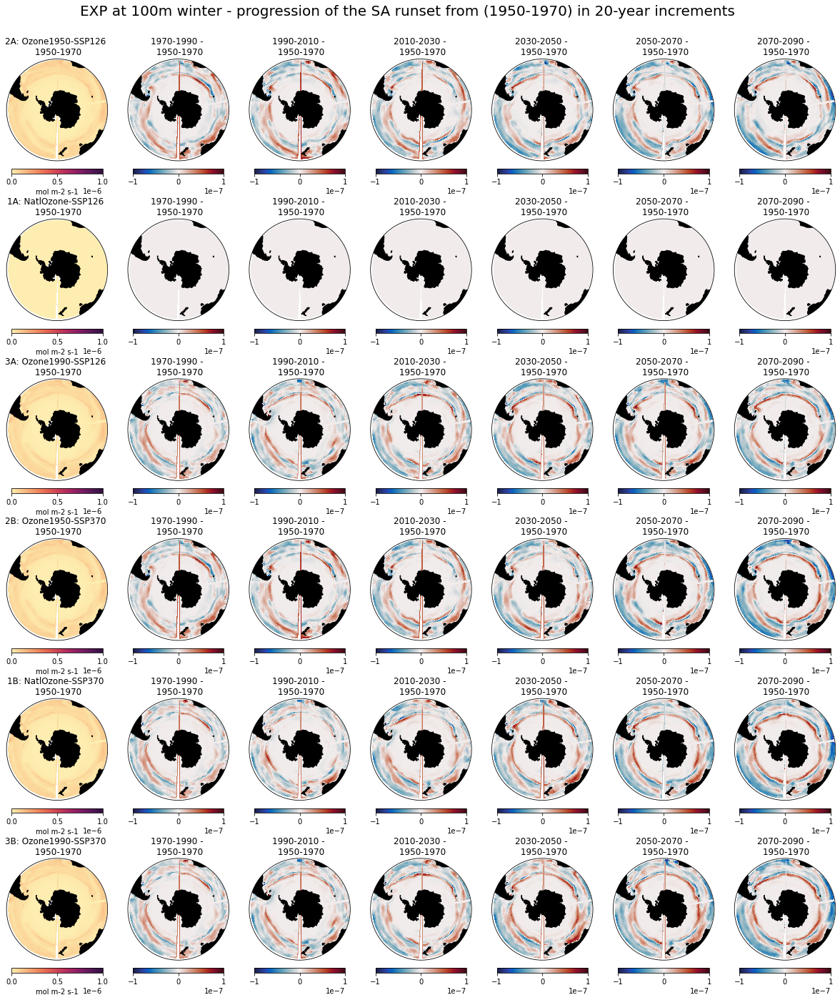

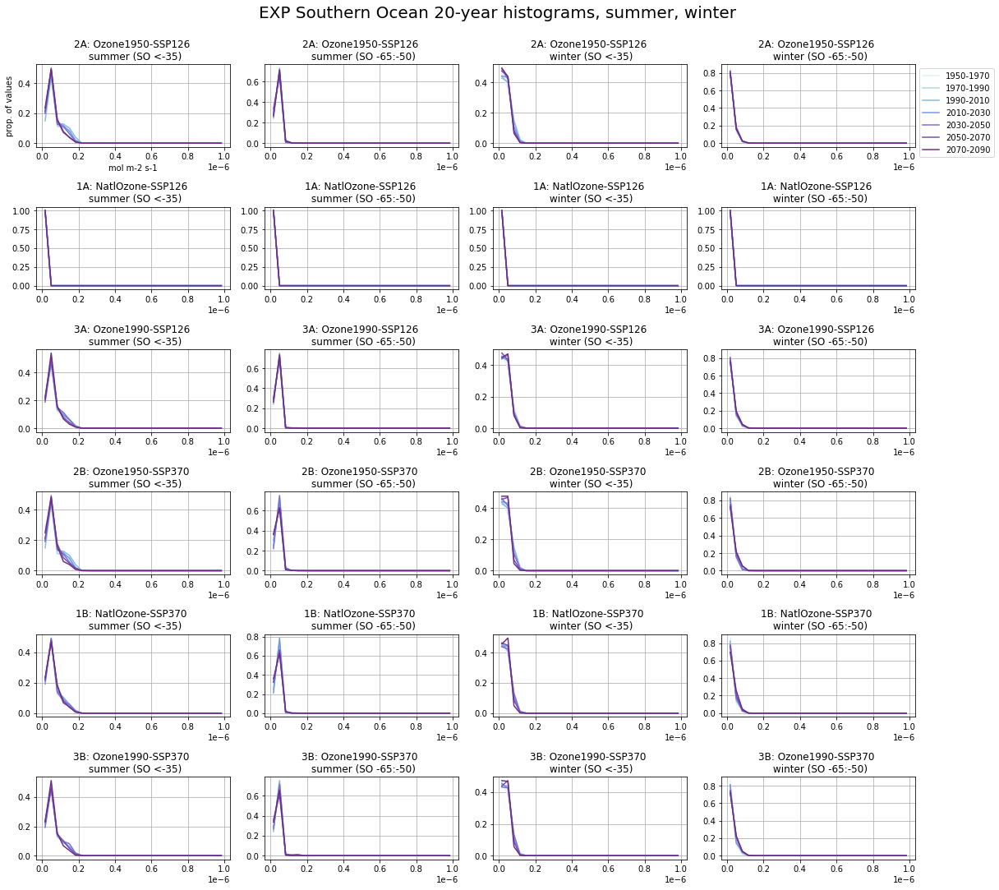

In [56]:
var = 'EXP'; varun = 'mol m-2 s-1'
#for histograms
vmin = 0; vmax = 1e-6
#for plots
tvmin = 0; tvmax = 1e-6; tticks = [0, 5e-7, 1e-6]
dmin = -1e-7; dmax = 1e-7; dtticks = [dmin, 0, dmax]
tcm = cm.matter

## summer maps
tseas = 'summer'; 
fact = 0.4
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplotst('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplotst('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplotst('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplotst('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplotst('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplotst('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} at 100m {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
## winter maps
tseas = 'winter'; 
tfig = plt.figure(figsize=[52*fact, 60*fact])
make_progplotst('2ASA','2A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 0)
make_progplotst('1ASA','1A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 7, titon= False)
make_progplotst('3ASA','3A',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 14, titon= False)
make_progplotst('2BSA','2B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 21, titon= False)
make_progplotst('1BSA','1B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 28, titon= False)
make_progplotst('3BSA','3B',var,varun,tseas,tcm,tvmin, tvmax, tticks, dmin, dmax, dtticks, 35, titon= False)
plt.suptitle(f'{var} at 100m {tseas} - progression of the SA runset from (1950-1970) in 20-year increments', fontsize = 20, y = 0.91)
tfig.savefig(f'./PIC/prog/{var}_{tseas}_progression_maps_SArunset.jpg',bbox_inches='tight')
#histograms
fact = 0.35
fig, axs = plt.subplots(6,4, figsize=(17, 2.5*6), facecolor='w', edgecolor='k')
axs = axs.ravel()
make_histos(var, varun, '2ASA', sc.scen['2A']['name2'], vmin, vmax, 0, tcm = cm.dense, leg = True)
make_histos(var, varun, '1ASA', sc.scen['1A']['name2'], vmin, vmax, 4, tcm = cm.dense)
make_histos(var, varun, '3ASA', sc.scen['3A']['name2'], vmin, vmax, 8, tcm = cm.dense)
make_histos(var, varun, '2BSA', sc.scen['2B']['name2'], vmin, vmax, 12, tcm = cm.dense)
make_histos(var, varun, '1BSA', sc.scen['1B']['name2'], vmin, vmax, 16, tcm = cm.dense)
make_histos(var, varun, '3BSA', sc.scen['3B']['name2'], vmin, vmax, 20, tcm = cm.dense)
plt.suptitle(f'{var} Southern Ocean 20-year histograms, summer, winter ', y = 1.0, fontsize= 20) 
plt.tight_layout()
fig.savefig(f'./PIC/prog/{var}_histograms_SArunset.jpg',bbox_inches='tight')



In [54]:
var = 'EXP'; runname = '1ASA'
tdir = '/gpfs/home/mep22dku/scratch/SOZONE/MO_RESULTS/EXTRACT/ncs/'
if var == 'wspd':
    w = xr.open_dataset(f'{tdir}/scen_{runname}_{var}_1948_2100.nc')
elif var == 'votemper':
    w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L0_1948_2100.nc')
elif var == 'EXP':
    w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_L10_1948_2100.nc')
else:
    w = xr.open_dataset(f'{tdir}/TOM12_TJ_{runname}_{var}_1948_2100.nc')
print(np.nanmax(w['EXP'].values))
print(np.nanmin(w['EXP'].values))

0.0
0.0
